In [2]:
import requests
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns                       #visualisation
import matplotlib.pyplot as plt             #visualisation
%matplotlib inline     
sns.set(color_codes=True)
from pathlib import Path

In [3]:
merge_data = pd.read_csv('merge_data.csv')
merge_data.head(5)

,review_count,rating,bike_station,free_bikes,empty_slots,latitude,longitude,distance
0,6.0,5.0,0,7,39,41.96909,-87.674237,64
1,6.0,5.0,0,7,39,41.96909,-87.674237,42
2,6.0,5.0,0,7,39,41.96909,-87.674237,172
3,6.0,5.0,0,7,39,41.96909,-87.674237,50
4,6.0,5.0,0,7,39,41.96909,-87.674237,47


In [4]:
#NUMBERS OF ROW AND COLUMNS
merge_data.shape 

(108040, 8)

In [5]:
merge_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 108040 entries, 0 to 108039
Data columns (total 8 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   review_count  108040 non-null  float64
 1   rating        108040 non-null  float64
 2   bike_station  108040 non-null  int64  
 3   free_bikes    108040 non-null  int64  
 4   empty_slots   108040 non-null  int64  
 5   latitude      108040 non-null  float64
 6   longitude     108040 non-null  float64
 7   distance      108040 non-null  int64  
dtypes: float64(4), int64(4)
memory usage: 6.6 MB


In [6]:
#SUMMARY STATATIC
merge_data.describe()

,review_count,rating,bike_station,free_bikes,empty_slots,latitude,longitude,distance
count,108040.000000,108040.000000,108040.000000,108040.000000,108040.000000,108040.000000,108040.000000,108040.0000
mean,112.556831,4.243613,292.118937,6.043132,9.433728,41.879777,-87.653774,116.6000
std,297.096537,0.848937,169.374708,4.576836,7.862702,0.078254,0.040165,64.9221
min,0.000000,0.000000,0.000000,0.000000,0.000000,41.648501,-87.774704,42.0000
25%,11.000000,4.000000,146.000000,2.000000,5.000000,41.834734,-87.677856,50.0000
50%,38.000000,4.500000,292.000000,5.000000,8.000000,41.886875,-87.652855,110.5000
75%,116.000000,4.500000,435.250000,9.000000,12.000000,41.931248,-87.629544,162.0000
max,9792.000000,5.000000,600.000000,25.000000,51.000000,42.064854,-87.528232,249.0000


In [7]:
#COUNT 0 VALUES IN ROWS
for column_name in merge_data.columns:
    count = (merge_data[column_name] == 0).sum()
    print('Num zeros in column', column_name, 'is:', count)

Num zeros in column review_count is: 770
Num zeros in column rating is: 770
Num zeros in column bike_station is: 200
Num zeros in column free_bikes is: 10520
Num zeros in column empty_slots is: 5180
Num zeros in column latitude is: 0
Num zeros in column longitude is: 0
Num zeros in column distance is: 0


In [8]:
cols_missing_vals = ['review_count', 'rating', 'bike_station', 'free_bikes' , 'empty_slots'] # cols with inappropriate 0s
merge_data[cols_missing_vals] = merge_data[cols_missing_vals].replace(0, np.NaN) # replace 0's with NaNs
merge_data.isnull().sum()

review_count      770
rating            770
bike_station      200
free_bikes      10520
empty_slots      5180
latitude            0
longitude           0
distance            0
dtype: int64

In [9]:
print("Shape before dropping NAs", merge_data.shape)

merge_data = merge_data.dropna(subset=['review_count', 'rating', 'bike_station', 'free_bikes' , 'empty_slots']) # drop rows with Glucose and BMI as NaN

print("Shape after dropping NAs from columns", merge_data.shape)

Shape before dropping NAs (108040, 8)
Shape after dropping NAs from columns (91400, 8)


In [10]:
merge_data.isnull().sum()


review_count    0
rating          0
bike_station    0
free_bikes      0
empty_slots     0
latitude        0
longitude       0
distance        0
dtype: int64

DETECTING OUTLINERS

<AxesSubplot:xlabel='free_bikes'>

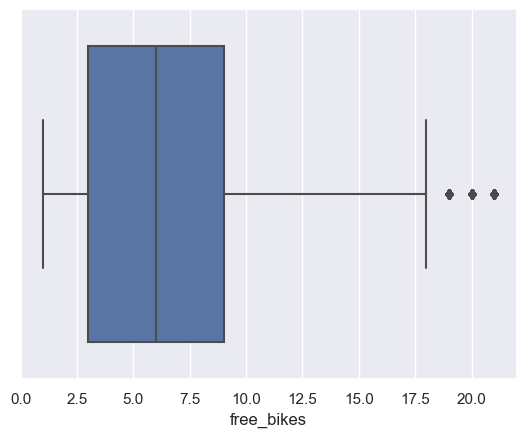

In [11]:
sns.boxplot(x=merge_data['free_bikes'])

<AxesSubplot:xlabel='empty_slots'>

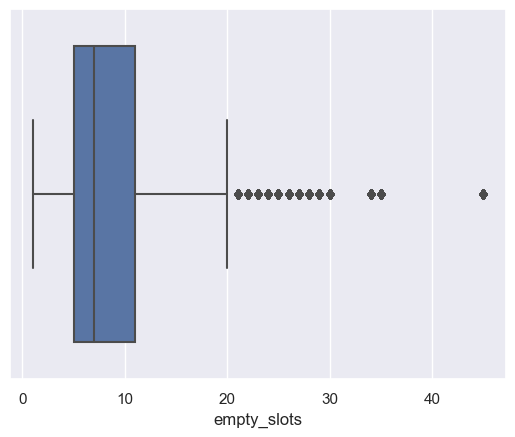

In [12]:
sns.boxplot(x=merge_data['empty_slots'])

<AxesSubplot:xlabel='rating'>

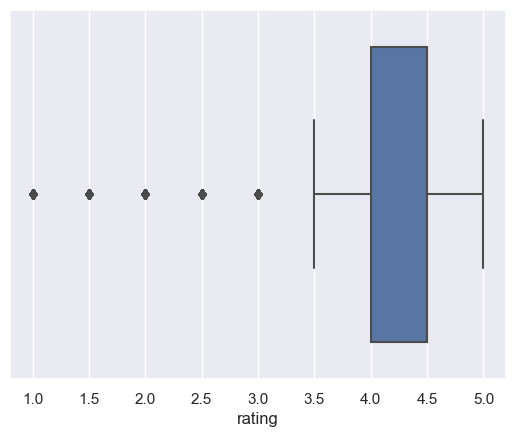

In [13]:
sns.boxplot(x=merge_data['rating'])

<AxesSubplot:xlabel='bike_station'>

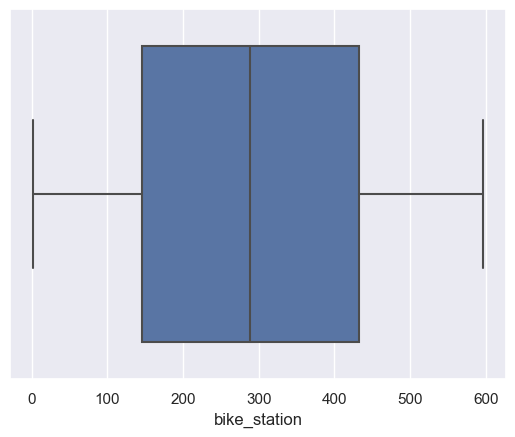

In [14]:
sns.boxplot(x=merge_data['bike_station'])

<AxesSubplot:xlabel='review_count'>

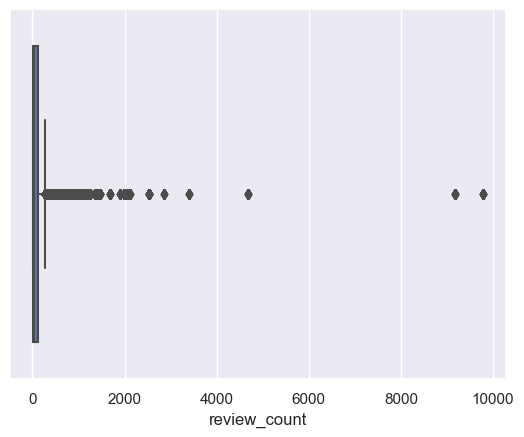

In [15]:
sns.boxplot(x=merge_data['review_count'])

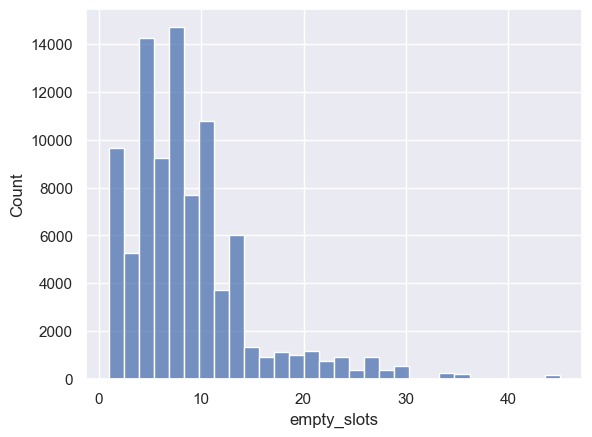

In [16]:
sns.set_theme(context = 'notebook',     #recomend context = 'talk'
              style = 'darkgrid',       
              palette = 'deep',
              font = 'sans-serif',
              font_scale = 1
              ) 

# you could also set a figure size that will affect all sns plots in your notebook
#sns.set(rc={"figure.figsize":(10, 6)}) 

#seaborn histogram
sns.histplot(data=merge_data, x="empty_slots", bins=30)

plt.show()

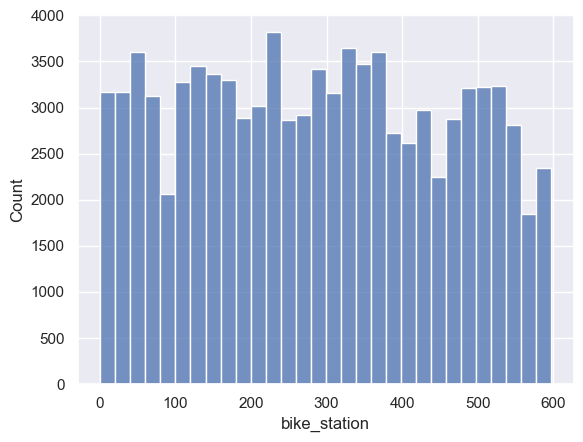

In [17]:
sns.set_theme(context = 'notebook',     #recomend context = 'talk'
              style = 'darkgrid',       
              palette = 'deep',
              font = 'sans-serif',
              font_scale = 1
              ) 

# you could also set a figure size that will affect all sns plots in your notebook
#sns.set(rc={"figure.figsize":(10, 6)}) 

#seaborn histogram
sns.histplot(data=merge_data, x="bike_station", bins=30)

plt.show()

Histogram of available bike stations in chicago city

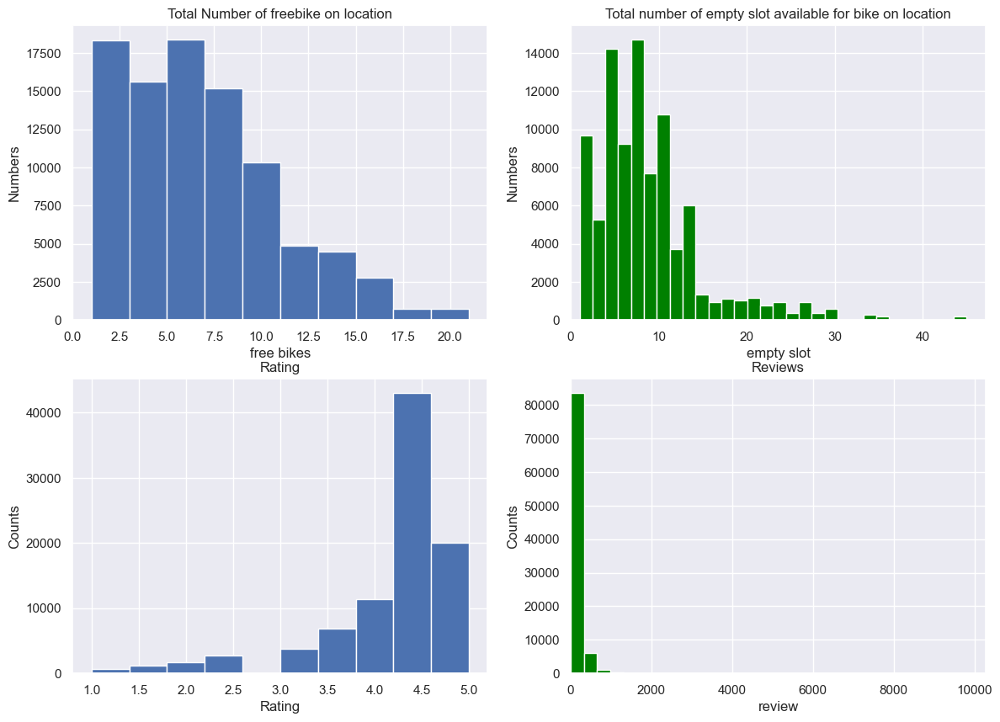

In [18]:
fig, axes = plt.subplots(nrows = 2, 
                         ncols = 2, 
                         figsize=(14, 10)        # units up to debate?
                        )

# Plot 0,0
axes[0,0].hist(merge_data['free_bikes'])
axes[0,0].set_title('Total Number of freebike on location')
axes[0,0].set_xlabel('free bikes')
axes[0,0].set_ylabel('Numbers')

# Plot 0,1
axes[0,1].hist(merge_data['empty_slots'], bins=30, color='green')
axes[0,1].set_title('Total number of empty slot available for bike on location')
axes[0,1].set_xlabel('empty slot')
axes[0,1].set_ylabel('Numbers')
axes[0,1].set_xlim(left=0)

# Plot 1,0
axes[1,0].hist(merge_data['rating'])
axes[1,0].set_title('Rating')
axes[1,0].set_xlabel('Rating')
axes[1,0].set_ylabel('Counts')

# Plot 1,1
axes[1,1].hist(merge_data['review_count'], bins=30, color='green')
axes[1,1].set_title('Reviews')
axes[1,1].set_xlabel('review')
axes[1,1].set_ylabel('Counts')
axes[1,1].set_xlim(left=0)

plt.show()

Using Two Variable:

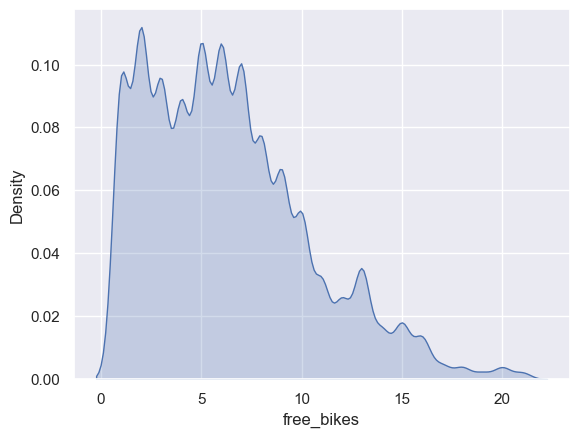

In [19]:
sns.kdeplot(data=merge_data, 
            x="free_bikes", 
            fill=True)
plt.show()

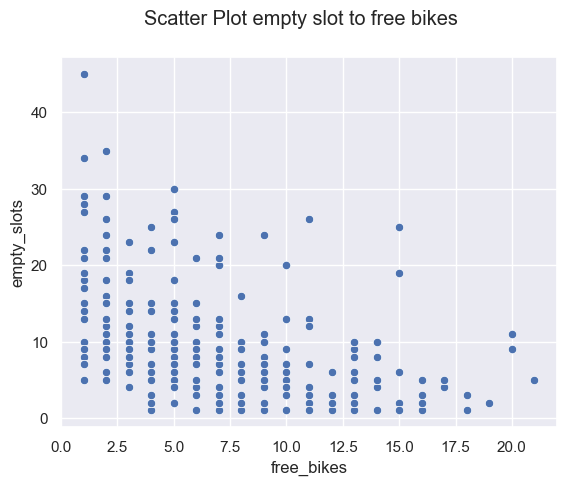

In [21]:
sns.scatterplot(data = merge_data, 
                x = "free_bikes", 
                y = "empty_slots")
plt.suptitle("Scatter Plot empty slot to free bikes")

plt.show()


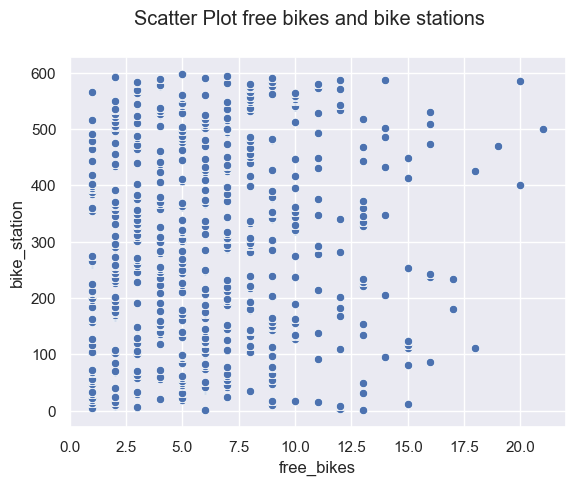

In [22]:
sns.scatterplot(data=merge_data, x='free_bikes', y='bike_station')
plt.suptitle("Scatter Plot free bikes and bike stations")

plt.show()

In [25]:
merge_data.corr()

,review_count,rating,bike_station,free_bikes,empty_slots,latitude,longitude,distance
review_count,1.000000e+00,6.240649e-02,-3.966171e-02,-5.092373e-04,6.462659e-02,1.016272e-01,-2.466244e-02,1.969096e-16
rating,6.240649e-02,1.000000e+00,-1.390372e-01,1.272024e-01,1.353627e-01,5.050687e-01,-1.892323e-01,2.470382e-16
bike_station,-3.966171e-02,-1.390372e-01,1.000000e+00,7.864489e-02,-7.048222e-02,-2.054845e-01,5.415065e-02,-4.305727e-15
free_bikes,-5.092373e-04,1.272024e-01,7.864489e-02,1.000000e+00,-4.779265e-01,8.396561e-02,5.806624e-02,1.607467e-17
empty_slots,6.462659e-02,1.353627e-01,-7.048222e-02,-4.779265e-01,1.000000e+00,9.825850e-02,9.094554e-02,1.025299e-17
latitude,1.016272e-01,5.050687e-01,-2.054845e-01,8.396561e-02,9.825850e-02,1.000000e+00,-5.687053e-01,6.562922e-16
longitude,-2.466244e-02,-1.892323e-01,5.415065e-02,5.806624e-02,9.094554e-02,-5.687053e-01,1.000000e+00,9.278072e-16
distance,1.969096e-16,2.470382e-16,-4.305727e-15,1.607467e-17,1.025299e-17,6.562922e-16,9.278072e-16,1.000000e+00


<AxesSubplot:>

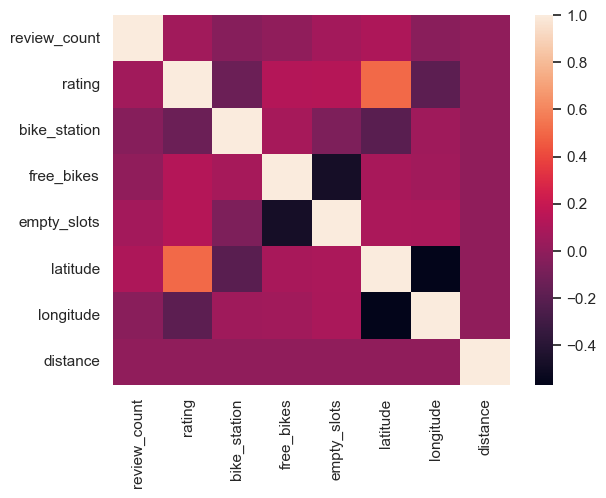

In [26]:
sns.heatmap(merge_data.corr())

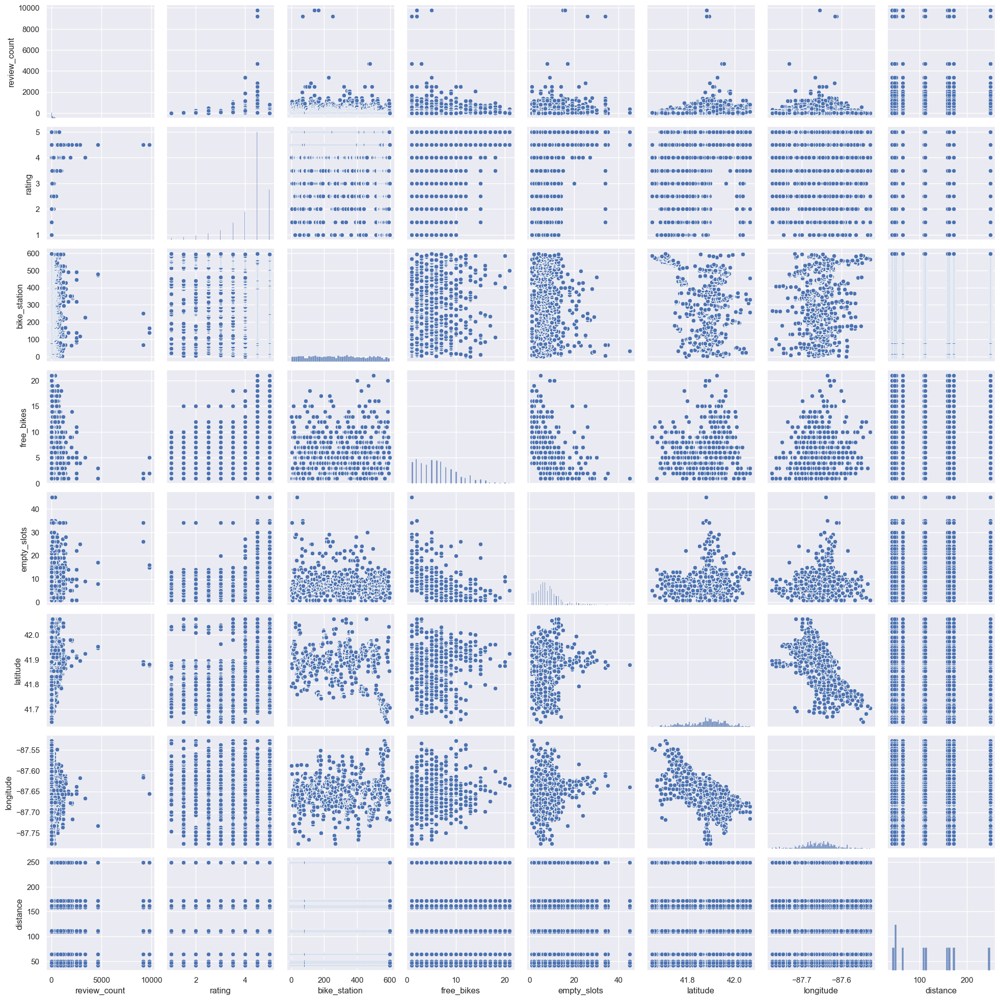

In [31]:
#view different graphs that perform pairwise comparisons all at once beyond just looking at the correlation.
sns.pairplot(merge_data)
plt.show()

array([[<AxesSubplot:xlabel='review_count', ylabel='review_count'>,
        <AxesSubplot:xlabel='rating', ylabel='review_count'>,
        <AxesSubplot:xlabel='bike_station', ylabel='review_count'>,
        <AxesSubplot:xlabel='free_bikes', ylabel='review_count'>,
        <AxesSubplot:xlabel='empty_slots', ylabel='review_count'>,
        <AxesSubplot:xlabel='latitude', ylabel='review_count'>,
        <AxesSubplot:xlabel='longitude', ylabel='review_count'>,
        <AxesSubplot:xlabel='distance', ylabel='review_count'>],
       [<AxesSubplot:xlabel='review_count', ylabel='rating'>,
        <AxesSubplot:xlabel='rating', ylabel='rating'>,
        <AxesSubplot:xlabel='bike_station', ylabel='rating'>,
        <AxesSubplot:xlabel='free_bikes', ylabel='rating'>,
        <AxesSubplot:xlabel='empty_slots', ylabel='rating'>,
        <AxesSubplot:xlabel='latitude', ylabel='rating'>,
        <AxesSubplot:xlabel='longitude', ylabel='rating'>,
        <AxesSubplot:xlabel='distance', ylabel='rating'>]

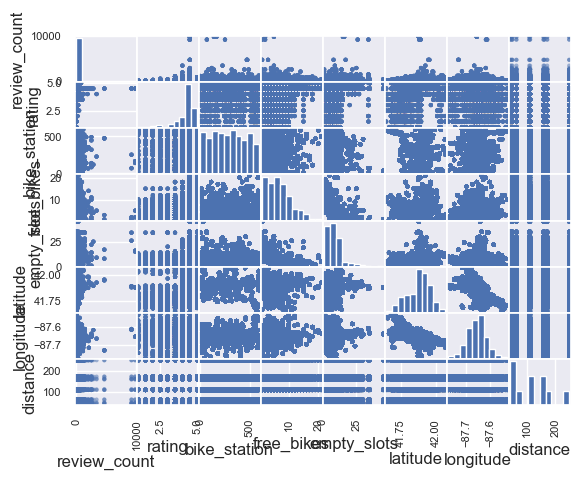

In [32]:
pd.plotting.scatter_matrix(merge_data)

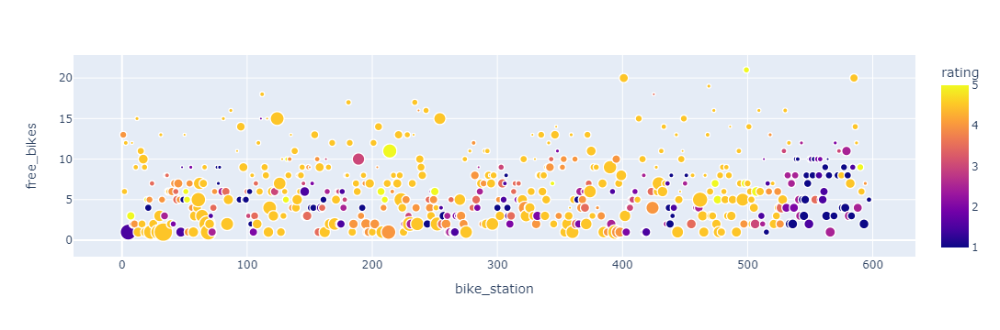

In [38]:
import plotly.express as px

fig = px.scatter(merge_data, x='bike_station', y='free_bikes', color='rating', size='empty_slots', hover_data=['distance'])
fig.show()

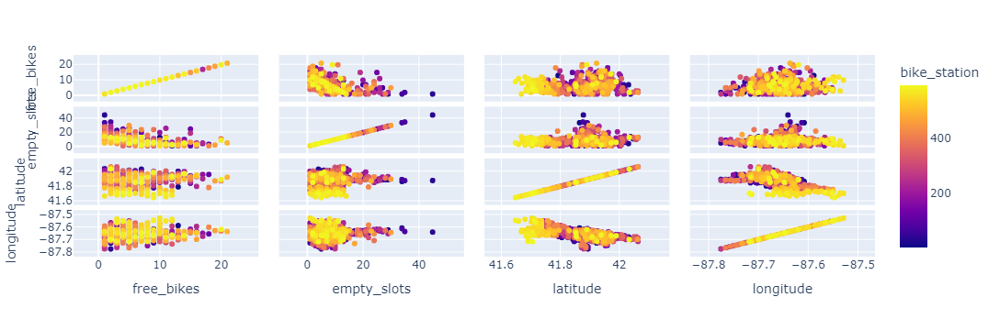

In [41]:
fig = px.scatter_matrix(merge_data,
                        dimensions=['free_bikes', 'empty_slots', 'latitude', 'longitude'],
                        hover_data=['rating', 'review_count'],
                        #hover_data=['latitude', 'longitude'],
                        color="bike_station")
fig.show()